In [ ]:
# ↓↓↓ AJOUTE cette cellule tout en haut du notebook ↓↓↓
!pip install numpy==1.24.4 numba==0.57.1 arch statsmodels --quiet
import os
os.kill(os.getpid(), 9)  # Redémarre automatiquement le runtime pour appliquer les nouvelles versions

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 88.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 87.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 985.3/985.3 kB 44.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.1/42.1 MB 17.0 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask-cuda 25.2.0 requires numba<0.61.0a0,>=0.59.1, but you have numba 0.57.1 which is incompatible.
jaxlib 0.5.1 requires numpy>=1.25, but you have numpy 1.24.4 which is incompatible.
jax 0.5.2 requires numpy>=1.25, but you have numpy 1.24.4 which is incompatible.
cuml-cu12 25.2.1 requires numba<0.61.0a0,>=0.59.1, but you have numba 0.57.1 which is incompatible.
tensorflow 2.18.0 requires numpy<2.1.0,>=1.26.0, but you have numpy 1.24.4 which is incompatible.
numba-cuda 0.2.0 requires numba>=0.59.1, but y

In [ ]:
# Importation des bibliothèques nécessaires

# Manipulation des données
import pandas as pd  # Pour la manipulation des DataFrames
import numpy as np   # Pour les calculs numériques

# Visualisation des données
import matplotlib.pyplot as plt  # Pour les graphiques de base
import seaborn as sns            # Pour des visualisations plus avancées

# Analyse des séries temporelles
from statsmodels.tsa.api import acf, pacf  # Pour l'autocorrélation
from arch import arch_model                # Pour les modèles GARCH

# Manipulation des fichiers et dossiers
import os  # Pour parcourir les fichiers dans un dossier

## Step 1 : Data Acquisition

In [ ]:
import os
import pandas as pd
from google.colab import files

# Télécharger les fichiers CSV depuis votre machine locale
uploaded = files.upload()

# Liste pour stocker les DataFrames
dfs = []

# Fonction pour extraire la paire de trading et la plateforme à partir du nom du fichier
def extract_pair_and_platform(filename):
    # Supprimer l'extension ".csv" et le suffixe " Historical Data"
    base_name = filename.replace('.csv', '').replace(' Historical Data', '')

    # Diviser le nom du fichier en deux parties : pair et plateforme
    parts = base_name.split(' ')
    if len(parts) == 2:
        pair = parts[0]  # Ex: ADA_USD
        platform = parts[1]  # Ex: Binance
    else:
        # Si le format n'est pas respecté, utiliser des valeurs par défaut
        pair = base_name  # Utiliser le nom du fichier sans extension
        platform = 'Unknown'  # Plateforme inconnue
    return pair, platform

# Parcourir tous les fichiers téléchargés
for filename in uploaded.keys():
    if filename.endswith('.csv'):
        # Charger le fichier CSV
        df = pd.read_csv(filename)

        # Extraire la paire de trading et la plateforme
        pair, platform = extract_pair_and_platform(filename)

        # Ajouter des colonnes pour la paire, la plateforme, l'asset et la quote
        df['Pair'] = pair
        df['Platform'] = platform
        df['Asset'] = pair.split('_')[0]  # Ex: ADA
        df['Quote'] = pair.split('_')[1]  # Ex: USD

        # Ajouter le DataFrame à la liste
        dfs.append(df)

# Combiner tous les DataFrames en un seul
combined_df = pd.concat(dfs, ignore_index=True)

# Afficher les premières lignes du DataFrame combiné
print("Premières lignes du DataFrame combiné :")
print(combined_df.head())

Saving ADA_USD Binance Historical Data.csv to ADA_USD Binance Historical Data.csv
Saving AVAX_USD CoinW Historical Data.csv to AVAX_USD CoinW Historical Data.csv
Saving BCH_USD Binance Historical Data.csv to BCH_USD Binance Historical Data.csv
Saving BNB_USD Gate.io Historical Data.csv to BNB_USD Gate.io Historical Data.csv
Saving BTC_USD Bitfinex Historical Data.csv to BTC_USD Bitfinex Historical Data.csv
Saving DOGE_USD Binance Historical Data.csv to DOGE_USD Binance Historical Data.csv
Saving ETC_USD Binance Historical Data.csv to ETC_USD Binance Historical Data.csv
Saving ETH_BTC Poloniex Historical Data.csv to ETH_BTC Poloniex Historical Data.csv
Saving ETH_USD Binance Historical Data.csv to ETH_USD Binance Historical Data.csv
Saving IOTA_USD Bitfinex Historical Data.csv to IOTA_USD Bitfinex Historical Data.csv
Saving LINK_USD Binance Historical Data.csv to LINK_USD Binance Historical Data.csv
Saving LTC_USD Binance Historical Data.csv to LTC_USD Binance Historical Data.csv
Saving

In [ ]:
# Télécharger le DataFrame combiné sous forme de fichier CSV
output_file = 'combined_crypto_data.csv'  # Nom du fichier de sortie
combined_df.to_csv(output_file, index=False)  # Sauvegarder sans l'index
print(f"\nLe dataset combiné a été téléchargé sous : {output_file}")


Le dataset combiné a été téléchargé sous : combined_crypto_data.csv


In [ ]:
# Affichage des premières lignes pour chaque paire de trading
# Groupby 'Pair' et récupération de la première ligne de chaque groupe (chaque paire)
first_rows_per_pair = combined_df.groupby('Pair').first()

# Affichage des premières lignes pour chaque paire
print("Premières lignes pour chaque paire (avec toutes les colonnes) :")
print(first_rows_per_pair)

# Pour visualiser les lignes avec des problèmes spécifiques (ex: guillemets, ou nommage erroné), vous pouvez utiliser le code suivant :

# Afficher les lignes où des problèmes de format sont présents (par exemple des guillemets)
print("\nExemples de lignes avec des guillemets ou des problèmes de nommage :")
problematic_rows = combined_df[combined_df['Pair'].str.contains(',')]
print(problematic_rows.head())  # Afficher les premières lignes avec des problèmes

Premières lignes pour chaque paire (avec toutes les colonnes) :
                             Date     Price      Open      High       Low  \
Pair                                                                        
ADA_USD                03/06/2025    0.9466    0.9742    0.9876     0.935   
AVAX_USD               03/06/2025     21.97     21.73     22.55     21.46   
BCH_USD                03/06/2025    397.40    392.80    419.80    384.70   
BNB_USD                03/06/2025     602.7     598.1     612.3     596.8   
BTC_USD                03/06/2025  91,611.0  90,848.0  92,997.0  90,245.0   
DOGE_USD               03/06/2025   0.20981   0.20451   0.21997   0.20236   
ETC_USD                03/06/2025     20.68     20.47     21.39     20.47   
ETH_BTC                03/06/2025   0.02504   0.02473   0.02514   0.02464   
ETH_USD                03/06/2025  2,292.20  2,241.12  2,319.80  2,235.28   
IOTA_USD               03/06/2025   0.22163   0.21981     0.227   0.21709   
LINK_USD    

## Step 2 : Data Understanding and Preparation

Global Explanation of the Dataset
1. Dataset Content

The dataset contains historical data on prices, volumes, and price changes of various cryptocurrencies and tokens traded on multiple platforms. Each row represents an observation for a specific period (e.g., a day), and each column provides specific information about that observation.

2. Purpose of the Dataset

This dataset enables you to:

Analyze the performance of cryptocurrencies and tokens (prices, volumes, changes).

Compare platforms (e.g., Binance vs. Bitfinex).

Study trends over time (e.g., price evolution over days, months, or years).

Identify opportunities (e.g., periods of high volatility or low liquidity).

the base asset. for prediction or classification models.

In [ ]:
# Afficher un résumé statistique des données numériques
print("\nRésumé statistique des données numériques :")
print(combined_df.describe())


Résumé statistique des données numériques :
              Date       Price        Open     High         Low   Vol.  \
count        36740  36740.0000  36740.0000  36740.0  36740.0000  36047   
unique        4779  28870.0000  29009.0000  28694.0  28354.0000  20856   
top     03/06/2025      0.9999      0.9999      1.0      0.9999  0.02K   
freq            19    187.0000    178.0000    185.0    155.0000     88   

       Change %     Pair Platform  Asset  Quote  
count     36740    36740    36740  36740  36740  
unique     3270       19        8     18      3  
top       0.00%  BTC_USD  Binance    ETH    USD  
freq        544     4778    22010   6081  32936  


In [ ]:
# Afficher les informations sur le DataFrame
print("\nInformations sur le DataFrame combiné :")
print(combined_df.info())


Informations sur le DataFrame combiné :
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36740 entries, 0 to 36739
Data columns (total 11 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   Date      36740 non-null  object
 1   Price     36740 non-null  object
 2   Open      36740 non-null  object
 3   High      36740 non-null  object
 4   Low       36740 non-null  object
 5   Vol.      36047 non-null  object
 6   Change %  36740 non-null  object
 7   Pair      36740 non-null  object
 8   Platform  36740 non-null  object
 9   Asset     36740 non-null  object
 10  Quote     36740 non-null  object
dtypes: object(11)
memory usage: 3.1+ MB
None


In [ ]:
# Conversion des colonnes pertinentes en valeurs numériques
# 1. Fixer les paires mal nommées (par exemple 'USDT_USD Coinbase Pro')
# Supprimer la plateforme du nom de la paire et la déplacer dans la colonne "Platform"
def fix_pair_names(pair_name):
    # Supprimer tout texte après un espace (la plateforme est généralement après l'espace)
    fixed_pair = pair_name.split(' ')[0]
    return fixed_pair

# Appliquer la correction du nom de la paire
combined_df['Pair'] = combined_df['Pair'].apply(fix_pair_names)

# 2. Fixer les problèmes de guillemets et de virgules dans les valeurs numériques
# Enlever les virgules et les guillemets des colonnes qui contiennent des valeurs numériques
def fix_numerical_format(value):
    if isinstance(value, str):
        return value.replace(',', '').replace('"', '')
    return value

# Appliquer la correction sur les colonnes numériques : 'Price', 'Open', 'High', 'Low', etc.
numerical_columns = ['Price', 'Open', 'High', 'Low']
for col in numerical_columns:
    combined_df[col] = combined_df[col].apply(fix_numerical_format)

# Convertir les colonnes numériques en types float
for col in numerical_columns:
    combined_df[col] = pd.to_numeric(combined_df[col], errors='coerce')

# 3. Vérifier que les modifications ont été appliquées correctement
print("Aperçu du DataFrame après correction :")
# Affichage des premières lignes pour chaque paire de trading
# Groupby 'Pair' et récupération de la première ligne de chaque groupe (chaque paire)
first_rows_per_pair = combined_df.groupby('Pair').first()

# Affichage des premières lignes pour chaque paire
print("Premières lignes pour chaque paire (avec toutes les colonnes) :")
print(first_rows_per_pair)

Aperçu du DataFrame après correction :
Premières lignes pour chaque paire (avec toutes les colonnes) :
                 Date        Price         Open         High          Low  \
Pair                                                                        
ADA_USD    03/06/2025      0.94660      0.97420      0.98760      0.93500   
AVAX_USD   03/06/2025     21.97000     21.73000     22.55000     21.46000   
BCH_USD    03/06/2025    397.40000    392.80000    419.80000    384.70000   
BNB_USD    03/06/2025    602.70000    598.10000    612.30000    596.80000   
BTC_USD    03/06/2025  91611.00000  90848.00000  92997.00000  90245.00000   
DOGE_USD   03/06/2025      0.20981      0.20451      0.21997      0.20236   
ETC_USD    03/06/2025     20.68000     20.47000     21.39000     20.47000   
ETH_BTC    03/06/2025      0.02504      0.02473      0.02514      0.02464   
ETH_USD    03/06/2025   2292.20000   2241.12000   2319.80000   2235.28000   
IOTA_USD   03/06/2025      0.22163      0.21981   

In [ ]:
# Remplacer 'Unknown' par 'Coinbase Pro' dans la colonne 'Platform'
combined_df['Platform'] = combined_df['Platform'].replace('Unknown', 'Coinbase Pro')

# Supprimer 'Coinbase Pro' de la colonne 'Quote'
combined_df['Quote'] = combined_df['Quote'].apply(lambda x: x.replace(' Coinbase Pro', '') if isinstance(x, str) else x)

# Affichage du DataFrame après modification
print("Aperçu du DataFrame après remplacement et nettoyage :")
first_rows_per_pair = combined_df.groupby('Pair').first()
print(first_rows_per_pair)

Aperçu du DataFrame après remplacement et nettoyage :
                 Date        Price         Open         High          Low  \
Pair                                                                        
ADA_USD    03/06/2025      0.94660      0.97420      0.98760      0.93500   
AVAX_USD   03/06/2025     21.97000     21.73000     22.55000     21.46000   
BCH_USD    03/06/2025    397.40000    392.80000    419.80000    384.70000   
BNB_USD    03/06/2025    602.70000    598.10000    612.30000    596.80000   
BTC_USD    03/06/2025  91611.00000  90848.00000  92997.00000  90245.00000   
DOGE_USD   03/06/2025      0.20981      0.20451      0.21997      0.20236   
ETC_USD    03/06/2025     20.68000     20.47000     21.39000     20.47000   
ETH_BTC    03/06/2025      0.02504      0.02473      0.02514      0.02464   
ETH_USD    03/06/2025   2292.20000   2241.12000   2319.80000   2235.28000   
IOTA_USD   03/06/2025      0.22163      0.21981      0.22700      0.21709   
LINK_USD   03/06/2025 

In [ ]:
# Supprimer '%' et convertir en float
combined_df['Change %'] = combined_df['Change %'].str.replace('%', '').astype(float, errors='ignore')

# Si vous souhaitez remplacer les valeurs invalides par NaN, vous pouvez utiliser pd.to_numeric
combined_df['Change %'] = pd.to_numeric(combined_df['Change %'], errors='coerce')

# Vérification des types de données après conversion
print("\nInformations sur le DataFrame après conversion :")
print(combined_df.info())


Informations sur le DataFrame après conversion :
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36740 entries, 0 to 36739
Data columns (total 11 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   Date      36740 non-null  object 
 1   Price     36740 non-null  float64
 2   Open      36740 non-null  float64
 3   High      36740 non-null  float64
 4   Low       36740 non-null  float64
 5   Vol.      36047 non-null  object 
 6   Change %  36739 non-null  float64
 7   Pair      36740 non-null  object 
 8   Platform  36740 non-null  object 
 9   Asset     36740 non-null  object 
 10  Quote     36740 non-null  object 
dtypes: float64(5), object(6)
memory usage: 3.1+ MB
None


In [ ]:
# Extraire les lettres uniques présentes dans la colonne 'Vol.'
letters_in_vol = combined_df['Vol.'].str.extractall('([A-Za-z])')[0].unique()

# Afficher les lettres uniques trouvées dans la colonne 'Vol.'
print("Lettres uniques dans la colonne 'Vol.':")
print(letters_in_vol)

Lettres uniques dans la colonne 'Vol.':
['M' 'B' 'K']


In [ ]:
# Nettoyer les espaces avant la conversion
combined_df['Vol.'] = combined_df['Vol.'].str.strip()

# Fonction de conversion avec gestion des suffixes
def convert_volume(vol_str):
    if isinstance(vol_str, str):
        suffix = vol_str[-1]  # Dernier caractère pour déterminer le suffixe
        vol_str = vol_str[:-1]  # Enlever le suffixe de la valeur
        try:
            value = float(vol_str)
            if suffix == 'K':
                return value * 1000  # Multiplier par 1000 si 'K'
            elif suffix == 'M':
                return value * 1000000  # Multiplier par 1 million si 'M'
            elif suffix == 'B':
                return value * 1000000000  # Multiplier par 1 milliard si 'B'
            else:
                return value  # Aucun suffixe, retourner la valeur telle quelle
        except ValueError:
            return None  # Retourner None si la conversion échoue
    return None

# Appliquer la conversion à la colonne 'Vol.'
combined_df['Vol.'] = combined_df['Vol.'].apply(convert_volume)

# Vérifier les premières lignes après conversion
print("\nPremières lignes de la colonne 'Vol.' après conversion mise à jour :")
print(combined_df['Vol.'].head())


Premières lignes de la colonne 'Vol.' après conversion mise à jour :
0    6.186800e+08
1    6.845500e+08
2    1.100000e+09
3    1.410000e+09
4    1.460000e+09
Name: Vol., dtype: float64


In [ ]:
# Conversion de la colonne 'Date' en format datetime avec un format spécifique
combined_df['Date'] = pd.to_datetime(combined_df['Date'], format='%m/%d/%Y', errors='coerce')

# Vérification des informations après la conversion
print("\nInformations sur le DataFrame après conversion de la date :")
print(combined_df.info())


Informations sur le DataFrame après conversion de la date :
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36740 entries, 0 to 36739
Data columns (total 11 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   Date      36740 non-null  datetime64[ns]
 1   Price     36740 non-null  float64       
 2   Open      36740 non-null  float64       
 3   High      36740 non-null  float64       
 4   Low       36740 non-null  float64       
 5   Vol.      36047 non-null  float64       
 6   Change %  36739 non-null  float64       
 7   Pair      36740 non-null  object        
 8   Platform  36740 non-null  object        
 9   Asset     36740 non-null  object        
 10  Quote     36740 non-null  object        
dtypes: datetime64[ns](1), float64(6), object(4)
memory usage: 3.1+ MB
None


Traitement des valeurs manquantes

In [ ]:
# Identifier les valeurs manquantes
missing_values = combined_df.isnull().sum()

# Afficher les résultats du nombre de valeurs manquantes
print("Valeurs manquantes par colonne :")
print(missing_values)

# Calculer le pourcentage de valeurs manquantes
missing_percentage = (missing_values / len(combined_df)) * 100

# Afficher le pourcentage de valeurs manquantes
print("\nPourcentage de valeurs manquantes par colonne :")
print(missing_percentage)

Valeurs manquantes par colonne :
Date          0
Price         0
Open          0
High          0
Low           0
Vol.        693
Change %      1
Pair          0
Platform      0
Asset         0
Quote         0
dtype: int64

Pourcentage de valeurs manquantes par colonne :
Date        0.000000
Price       0.000000
Open        0.000000
High        0.000000
Low         0.000000
Vol.        1.886228
Change %    0.002722
Pair        0.000000
Platform    0.000000
Asset       0.000000
Quote       0.000000
dtype: float64


In [ ]:
# Mettre en surbrillance les lignes ayant des valeurs manquantes dans toutes les colonnes
highlight_missing_all = combined_df.style.apply(
    lambda x: ['background-color: yellow' if pd.isnull(val) else '' for val in x],
    axis=1  # Applique à chaque ligne
)

# Afficher le DataFrame avec surbrillance des valeurs manquantes dans toutes les colonnes
highlight_missing_all

,Date,Price,Open,High,Low,Vol.,Change %,Pair,Platform,Asset,Quote
0,2025-03-06 00:00:00,0.946600,0.974200,0.987600,0.935000,618680000.000000,-2.820000,ADA_USD,Binance,ADA,USD
1,2025-03-05 00:00:00,0.974100,0.937200,1.017800,0.915100,684550000.000000,3.590000,ADA_USD,Binance,ADA,USD
2,2025-03-04 00:00:00,0.940300,0.856400,0.954200,0.758500,1100000000.000000,9.640000,ADA_USD,Binance,ADA,USD
3,2025-03-03 00:00:00,0.857600,1.148800,1.163900,0.825300,1410000000.000000,-24.500000,ADA_USD,Binance,ADA,USD
4,2025-03-02 00:00:00,1.135900,0.658500,1.143000,0.645000,1460000000.000000,72.340000,ADA_USD,Binance,ADA,USD
5,2025-03-01 00:00:00,0.659100,0.633000,0.676200,0.625400,101840000.000000,4.160000,ADA_USD,Binance,ADA,USD
6,2025-02-28 00:00:00,0.632800,0.645500,0.646500,0.581300,258110000.000000,-1.910000,ADA_USD,Binance,ADA,USD
7,2025-02-27 00:00:00,0.645100,0.648000,0.679700,0.626500,119340000.000000,-0.360000,ADA_USD,Binance,ADA,USD
8,2025-02-26 00:00:00,0.647400,0.683700,0.695100,0.632900,188680000.000000,-5.230000,ADA_USD,Binance,ADA,USD
9,2025-02-25 00:00:00,0.683100,0.681100,0.694900,0.631600,314620000.000000,0.380000,ADA_USD,Binance,ADA,USD


In [ ]:
# Liste pour stocker les indices où l'interpolation est possible pour chaque colonne
can_interpolate_indices_per_column = {}

# Vérifier chaque colonne pour les indices où l'interpolation est possible
for column in combined_df.columns:
    missing_indices = combined_df[combined_df[column].isnull()].index
    can_interpolate_indices = []

    for idx in missing_indices:
        # Vérifier si le prédécesseur et le successeur sont non NaN
        if idx > 0 and idx < len(combined_df) - 1:
            if pd.notnull(combined_df[column].iloc[idx - 1]) and pd.notnull(combined_df[column].iloc[idx + 1]):
                can_interpolate_indices.append(idx)

    # Ajouter les indices pour cette colonne
    can_interpolate_indices_per_column[column] = can_interpolate_indices

# Afficher les indices où interpolation est possible pour chaque colonne
for column, indices in can_interpolate_indices_per_column.items():
    print(f"Indices pouvant être interpolés dans la colonne '{column}': {indices}")

Indices pouvant être interpolés dans la colonne 'Date': []
Indices pouvant être interpolés dans la colonne 'Price': []
Indices pouvant être interpolés dans la colonne 'Open': []
Indices pouvant être interpolés dans la colonne 'High': []
Indices pouvant être interpolés dans la colonne 'Low': []
Indices pouvant être interpolés dans la colonne 'Vol.': [4831, 10157, 10541, 10580, 17797, 17897, 20576, 23720]
Indices pouvant être interpolés dans la colonne 'Change %': [14467]
Indices pouvant être interpolés dans la colonne 'Pair': []
Indices pouvant être interpolés dans la colonne 'Platform': []
Indices pouvant être interpolés dans la colonne 'Asset': []
Indices pouvant être interpolés dans la colonne 'Quote': []


In [ ]:
# Liste des indices où l'interpolation est possible pour chaque colonne
interpolation_indices = {
    'Vol.': [4831, 10157, 10541, 10580, 17797, 17897, 20576, 23720],
    'Change %': [14467]
}

# Appliquer l'interpolation uniquement aux indices spécifiques pour chaque colonne
for col, indices in interpolation_indices.items():
    # Pour chaque indice où l'interpolation est nécessaire
    for idx in indices:
        if pd.isnull(combined_df[col].iloc[idx]):
            # Trouver les indices voisins pour l'interpolation
            # Trouver l'indice précédent et suivant valide pour interpolation linéaire
            prev_idx = combined_df[col].iloc[:idx].last_valid_index()
            next_idx = combined_df[col].iloc[idx:].first_valid_index()

            if prev_idx is not None and next_idx is not None:
                # Appliquer l'interpolation linéaire entre les deux indices valides
                combined_df[col].iloc[idx] = combined_df[col].iloc[prev_idx] + (
                    combined_df[col].iloc[next_idx] - combined_df[col].iloc[prev_idx]
                ) * (idx - prev_idx) / (next_idx - prev_idx)

# Afficher un message indiquant que l'imputation est réussie
print("Imputation réussie avec interpolation linéaire pour les indices spécifiés.")

# Afficher les lignes modifiées
print("\nLignes modifiées après imputation :")
print(combined_df.iloc[interpolation_indices['Vol.'] + interpolation_indices['Change %']])

Imputation réussie avec interpolation linéaire pour les indices spécifiés.

Lignes modifiées après imputation :
            Date      Price       Open       High        Low        Vol.  \
4831  2019-11-29  220.08000  220.08000  220.08000  220.08000     90200.0   
10157 2015-01-23  235.00000  230.00000  235.00000  215.00000         0.0   
10541 2014-01-03  812.10000  801.00000  812.10000  801.00000        70.0   
10580 2013-11-24  813.70000  746.90000  813.70000  746.90000        35.0   
17797 2017-06-04    0.08743    0.08743    0.08743    0.08743    312625.0   
17897 2017-02-24    0.01127    0.01127    0.01127    0.01127    235810.0   
20576 2019-05-19  240.62000  240.62000  240.62000  240.62000    235550.0   
23720 2017-11-26    0.80550    0.80550    0.80550    0.80550  39290000.0   
14467 2021-05-10  104.90000  119.17200  119.17200   99.65400  15160000.0   

       Change %      Pair  Platform Asset Quote  
4831      0.000   BCH_USD   Binance   BCH   USD  
10157     3.840   BTC_USD  

<ipython-input-26-29759d905992>:19: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  combined_df[col].iloc[idx] = combined_df[col].iloc[prev_idx] + (
<ipython-input-26-29759d905992>:19: SettingWithCopyWarning: 
A value is trying to be set on a 

In [ ]:
from sklearn.impute import KNNImputer
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error

cols_to_impute = ['Vol.']  # Vous pouvez ajouter d'autres colonnes si nécessaire

# Créer une instance du KNNImputer
imputer = KNNImputer()

# Paramètres à tester pour le GridSearch
param_grid = {
    'n_neighbors': [3, 5, 7, 9, 11]  # Vous pouvez ajuster ces valeurs
}

# Appliquer un GridSearch pour trouver le meilleur nombre de voisins
grid_search = GridSearchCV(imputer, param_grid, cv=5, scoring='neg_mean_squared_error', verbose=1)

# Effectuer l'imputation sur la colonne spécifique (en utilisant GridSearch)
grid_search.fit(combined_df[cols_to_impute])

# Afficher les meilleurs paramètres trouvés
print("Meilleur nombre de voisins (n_neighbors) trouvé :", grid_search.best_params_)

# Appliquer l'imputation avec les meilleurs paramètres
best_imputer = grid_search.best_estimator_
combined_df[cols_to_impute] = best_imputer.transform(combined_df[cols_to_impute])

# Vérifiez les valeurs manquantes après l'imputation
print("Valeurs manquantes après imputation :")
print(combined_df[cols_to_impute].isnull().sum())

# Afficher un aperçu des premières lignes après l’imputation
print("\nAperçu des premières lignes du DataFrame après imputation :")
print(combined_df.head())

Fitting 5 folds for each of 5 candidates, totalling 25 fits
Meilleur nombre de voisins (n_neighbors) trouvé : {'n_neighbors': 3}


/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:960: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py", line 947, in _score
    scores = scorer(estimator, X_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
TypeError: _BaseScorer.__call__() missing 1 required positional argument: 'y_true'

  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py:960: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/sklearn/model_selection/_validation.py", line 947, in _score
    scores = scorer(estimator, X_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^

Valeurs manquantes après imputation :
Vol.    0
dtype: int64

Aperçu des premières lignes du DataFrame après imputation :
        Date   Price    Open    High     Low          Vol.  Change %     Pair  \
0 2025-03-06  0.9466  0.9742  0.9876  0.9350  6.186800e+08     -2.82  ADA_USD   
1 2025-03-05  0.9741  0.9372  1.0178  0.9151  6.845500e+08      3.59  ADA_USD   
2 2025-03-04  0.9403  0.8564  0.9542  0.7585  1.100000e+09      9.64  ADA_USD   
3 2025-03-03  0.8576  1.1488  1.1639  0.8253  1.410000e+09    -24.50  ADA_USD   
4 2025-03-02  1.1359  0.6585  1.1430  0.6450  1.460000e+09     72.34  ADA_USD   

  Platform Asset Quote  
0  Binance   ADA   USD  
1  Binance   ADA   USD  
2  Binance   ADA   USD  
3  Binance   ADA   USD  
4  Binance   ADA   USD  


In [ ]:
# Vérifier s'il y a des valeurs négatives dans la colonne 'Vol.'
negative_vol = combined_df[combined_df['Vol.'] < 0]

# Afficher les lignes avec des valeurs négatives dans la colonne 'Vol.'
print(negative_vol)

            Date     Price      Open      High       Low          Vol.  \
12740 2021-01-28  0.036201  0.007405  0.036201  0.007405 -8.154000e+10   

       Change %      Pair Platform Asset Quote  
12740    386.29  DOGE_USD  Binance  DOGE   USD  


In [ ]:
# Remplacer les valeurs négatives par NaN dans la colonne 'Vol.'
combined_df['Vol.'] = combined_df['Vol.'].apply(lambda x: x if x > 0 else None)

In [ ]:
# Afficher la ligne contenant la valeur négative avant modification
negative_vol_line = combined_df[combined_df['Vol.'] == -8.154000e+10]

# Afficher la ligne spécifique
print("\nLigne contenant la valeur négative avant modification :")
print(negative_vol_line)


Ligne contenant la valeur négative avant modification :
Empty DataFrame
Columns: [Date, Price, Open, High, Low, Vol., Change %, Pair, Platform, Asset, Quote]
Index: []


In [ ]:
from sklearn.preprocessing import MinMaxScaler

# Créer un scaler MinMax
scaler = MinMaxScaler()

# Appliquer la normalisation Min-Max sur la colonne 'Vol.'
combined_df['Vol.'] = scaler.fit_transform(combined_df[['Vol.']])

# Afficher un aperçu après normalisation
print("\nAperçu des premières lignes après normalisation Min-Max :")
print(combined_df[['Vol.']].head())


Aperçu des premières lignes après normalisation Min-Max :
       Vol.
0  0.430849
1  0.431195
2  0.433374
3  0.434999
4  0.435261


## Step 3 : Data Visualization

<ipython-input-22-332b7f6a0b69>:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=asset_counts.index, y=asset_counts.values, palette="viridis")


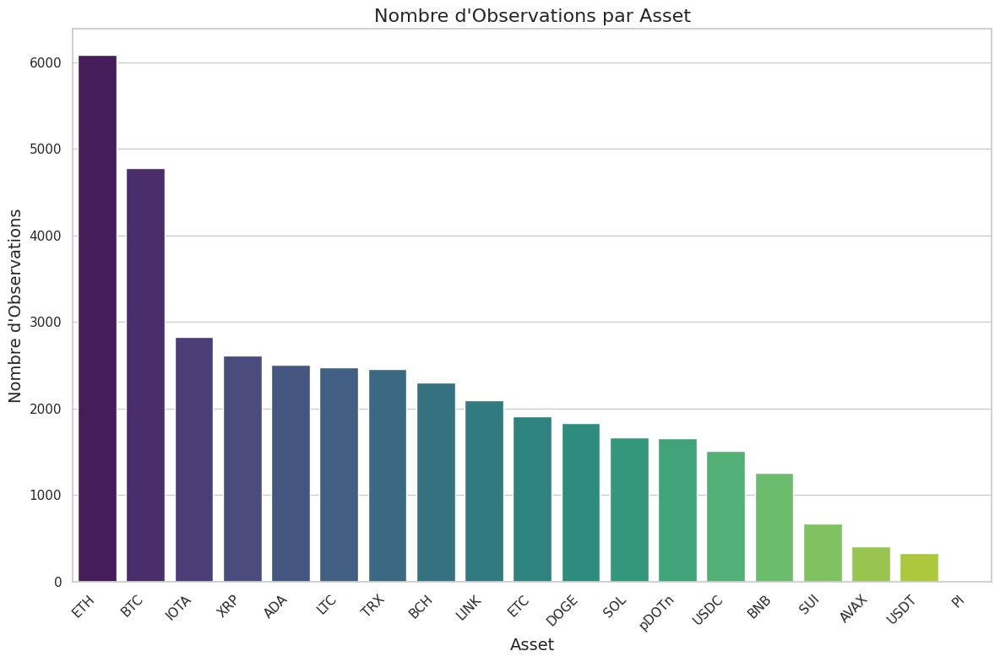

In [ ]:
# Compter le nombre d'observations par asset
asset_counts = combined_df['Asset'].value_counts()

# Configuration des graphiques
plt.figure(figsize=(12, 8))
sns.set(style="whitegrid")

# Tracer un graphique à barres
sns.barplot(x=asset_counts.index, y=asset_counts.values, palette="viridis")

# Ajouter des labels et un titre
plt.title('Nombre d\'Observations par Asset', fontsize=16)
plt.xlabel('Asset', fontsize=14)
plt.ylabel('Nombre d\'Observations', fontsize=14)
plt.xticks(rotation=45, ha='right')  # Rotation des labels pour une meilleure lisibilité

# Afficher le graphique
plt.tight_layout()
plt.show()

### Interpretation of the Results :

The graph shows the number of observations by asset. **ETH (Ethereum)** is the most frequent, with over 6000 observations, followed by **BTC (Bitcoin)**, then **IOTA**, **XRP**, **ADA**, and **LTC**.

**ETH Leading:** Ethereum's high frequency is due to its adoption in decentralized applications (dApps), smart contracts, and DeFi. The constant development of Ethereum 2.0 also contributes to its popularity.

**BTC's Position:** Bitcoin remains highly traded as the first cryptocurrency and a store of value, maintaining a strong presence in the dataset.

**Other Assets:** Assets like IOTA, XRP, ADA, and LTC have fewer observations, but their niche use cases (e.g., IoT for IOTA, cross-border payments for XRP) keep them relevant.

**Reasons for These Results**

**Popularity:** Ethereum and Bitcoin dominate due to their widespread adoption and use cases, such as trading, DeFi, and smart contracts.

**Technological Innovation:** Ethereum’s transition to Ethereum 2.0 and Bitcoin’s role as a store of value contribute to their prominence.

**Specialized Communities:** Other assets have dedicated but smaller communities, driving their appearance in the dataset despite lower activity.

In [ ]:
# Trier d'abord par 'Pair' puis par 'Date' pour chaque pair indépendamment
combined_df = combined_df.sort_values(by=['Pair', 'Date'])

# Assurez-vous que le DataFrame est trié correctement
print(combined_df.head())  # Vérifie que les données sont triées par pair et par date

           Date   Price    Open    High     Low      Vol.  Change %     Pair  \
2506 2018-04-26  0.2933  0.2687  0.2939  0.2572  0.000624      9.21  ADA_USD   
2505 2018-04-27  0.2845  0.2934  0.3058  0.2831  0.000640     -3.00  ADA_USD   
2504 2018-04-28  0.3561  0.2840  0.3645  0.2821  0.001547     25.17  ADA_USD   
2503 2018-04-29  0.3625  0.3568  0.3860  0.3428  0.001492      1.82  ADA_USD   
2502 2018-04-30  0.3410  0.3625  0.3629  0.3307  0.000853     -5.94  ADA_USD   

     Platform Asset Quote  
2506  Binance   ADA   USD  
2505  Binance   ADA   USD  
2504  Binance   ADA   USD  
2503  Binance   ADA   USD  
2502  Binance   ADA   USD  


Veuillez entrer le Pair (ex: 'BTC_USD'): BTC_USD


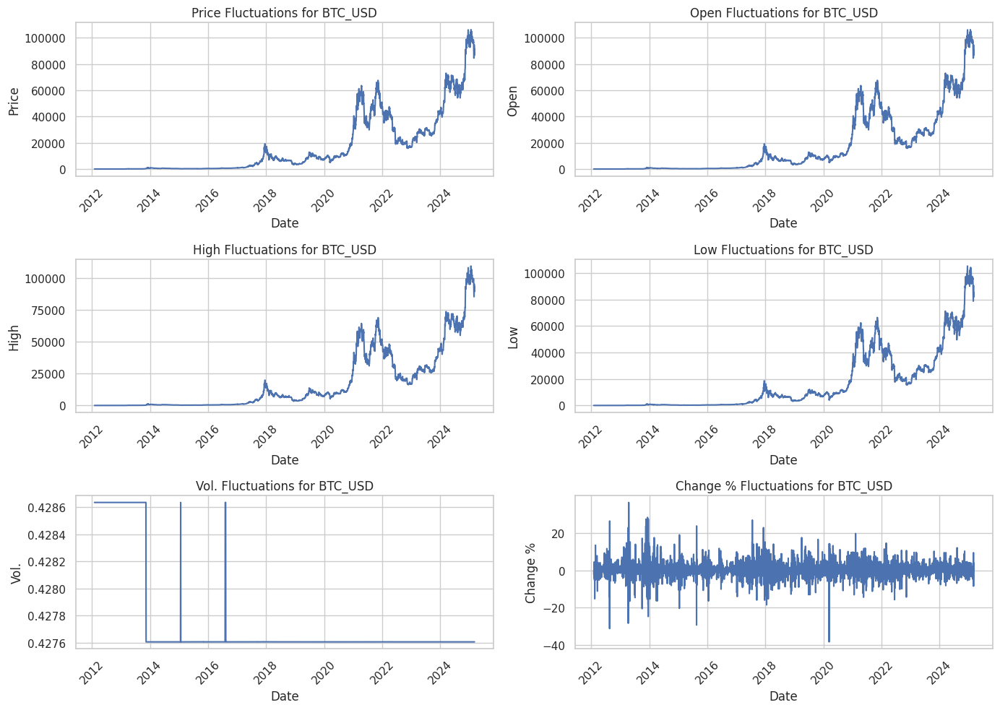

In [ ]:
# Demander à l'utilisateur de saisir un 'Pair' spécifique
pair_input = input("Veuillez entrer le Pair (ex: 'BTC_USD'): ")

# Vérifier si le Pair saisi existe dans le DataFrame
if pair_input in combined_df['Pair'].unique():
    # Filtrer les données pour le Pair spécifié
    pair_data = combined_df[combined_df['Pair'] == pair_input]

    # Tracer les courbes pour chaque variable
    plt.figure(figsize=(14, 10))

    # Liste des variables à tracer
    variables = ['Price', 'Open', 'High', 'Low', 'Vol.', 'Change %']

    # Création d'un sous-graphique pour chaque variable
    for i, var in enumerate(variables, 1):
        plt.subplot(3, 2, i)  # Création de 3 lignes et 2 colonnes de graphiques
        plt.plot(pair_data['Date'], pair_data[var], label=var)
        plt.title(f'{var} Fluctuations for {pair_input}')
        plt.xlabel('Date')
        plt.ylabel(var)
        plt.xticks(rotation=45)
        plt.grid(True)

    plt.tight_layout()  # Ajuster l'espacement entre les graphiques
    plt.show()
else:
    print(f"Le Pair '{pair_input}' n'existe pas dans les données.")

### BTC_USD Interpretation:
The graph shows an overall upward trend for Bitcoin with notable peaks:

**2018 Peak (20,000 USD):** Driven by market speculation and media hype, followed by a correction.

**2018-2021 Stability:** A period of consolidation, likely due to market corrections and increasing regulation.

**2021 Peak (60,000 USD):** Growth fueled by institutional adoption and the COVID-19 pandemic.

**Post-2021 Decline:** A correction due to reduced liquidity and regulatory concerns.

**2025 Forecasted Peak (>100,000 USD):** Expected rise due to ongoing adoption and technological advances.

**Reasons:**

**Speculation:** Major peaks driven by market hype.

**Institutional Adoption:** Increased interest from financial institutions.

**Macroeconomic Factors:** Monetary policies and inflation concerns impact prices.

Veuillez entrer le Pair (ex: 'BTC_USD'): ETH_USD


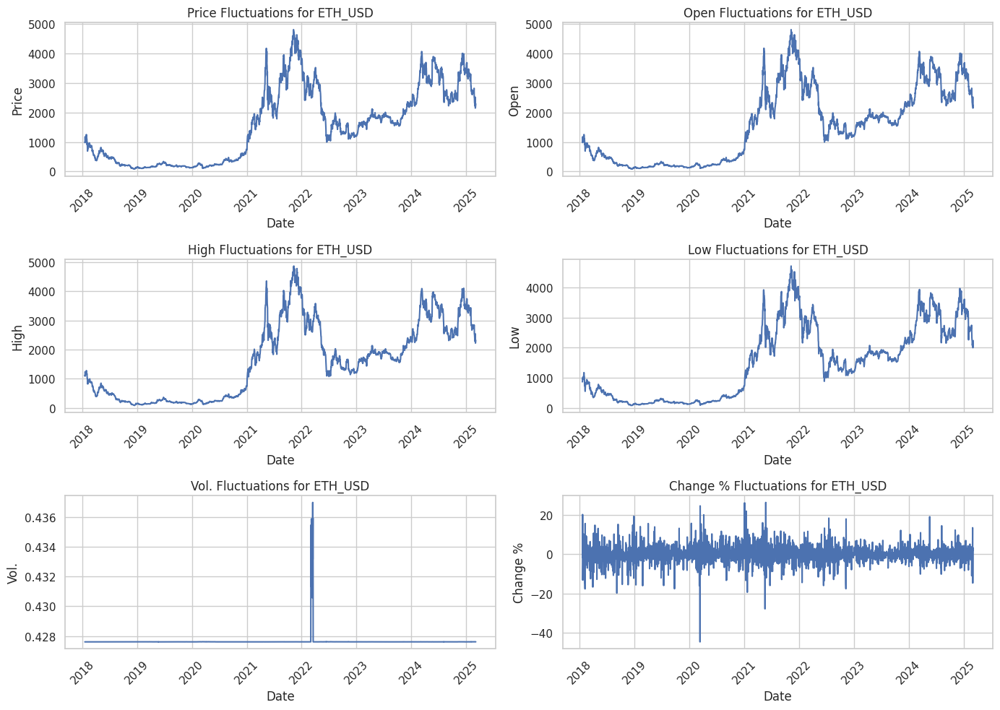

In [ ]:
# Demander à l'utilisateur de saisir un 'Pair' spécifique
pair_input = input("Veuillez entrer le Pair (ex: 'BTC_USD'): ")

# Vérifier si le Pair saisi existe dans le DataFrame
if pair_input in combined_df['Pair'].unique():
    # Filtrer les données pour le Pair spécifié
    pair_data = combined_df[combined_df['Pair'] == pair_input]

    # Tracer les courbes pour chaque variable
    plt.figure(figsize=(14, 10))

    # Liste des variables à tracer
    variables = ['Price', 'Open', 'High', 'Low', 'Vol.', 'Change %']

    # Création d'un sous-graphique pour chaque variable
    for i, var in enumerate(variables, 1):
        plt.subplot(3, 2, i)  # Création de 3 lignes et 2 colonnes de graphiques
        plt.plot(pair_data['Date'], pair_data[var], label=var)
        plt.title(f'{var} Fluctuations for {pair_input}')
        plt.xlabel('Date')
        plt.ylabel(var)
        plt.xticks(rotation=45)
        plt.grid(True)

    plt.tight_layout()  # Ajuster l'espacement entre les graphiques
    plt.show()
else:
    print(f"Le Pair '{pair_input}' n'existe pas dans les données.")

### ETH_USD Interpretation:

The graph for Ethereum (ETH) shows significant fluctuations over time:

**2018-2020 Initial Drop:** Starting at 1000 USD, Ethereum experiences a sharp decline, almost approaching 0. This could be attributed to market corrections and a lack of widespread adoption during that period.

**2021 Surge:** A strong increase, reaching a peak of around 5000 USD, driven by DeFi (Decentralized Finance) growth, smart contract usage, and growing interest in NFTs (Non-Fungible Tokens).

**Mid-2022 Drop and Stability:** After the 2022 peak, Ethereum returns to 1000 USD by mid-2022. The fluctuations and slight decline could be caused by market consolidation, lower demand, and the global economic environment.

**2023-2024 Low Volatility:** Ethereum shows weak growth with low volatility, reflecting market caution, possibly due to regulatory uncertainty and less speculative trading.

**2025 Recovery:** Starting from 2024, Ethereum experiences renewed growth, likely driven by increasing blockchain adoption and the anticipation of Ethereum 2.0’s full implementation.

**Reasons:**

**Technological Advances:** Ethereum’s fluctuations are influenced by improvements in its ecosystem, such as the Ethereum 2.0 upgrade.

**Market Cycles:** Similar to Bitcoin, Ethereum follows cycles of hype and correction, often tied to trends like DeFi and NFTs.

**Economic Factors:** Broader market conditions, such as inflation and regulation, impact Ethereum’s price movements.

In [ ]:
import pandas as pd

# Supposons que ton DataFrame avec les données prétraitées s'appelle df
# Tu peux remplacer 'df' par le nom réel de ton DataFrame

combined_df.to_csv("processed_crypto_data.csv", index=False)

print("Fichier 'processed_crypto_data.csv' enregistré avec succès.")


Fichier 'processed_crypto_data.csv' enregistré avec succès.
